# Bridging Python and Julia for Enhanced Data Analysis

Data format conversion is the hardest part of language boundary-hopping. 

Physicists are using Awkward Array in Python. 

[AwkwardArray.jl](https://github.com/JuliaHEP/AwkwardArray.jl) allows sharing Awkward Array data structures between Python and Julia. 

In [1]:
import awkward as ak
import numpy as np
import matplotlib.pyplot as plt

[PythonCall and JuliaCall](https://github.com/JuliaPy/PythonCall.jl) allow to call Python code from Julia and Julia code from Python via a symmetric interface.

```python
conda install conda-forge::pyjuliacall
```
JuliaCall uses [JuliaUp](https://github.com/JuliaLang/juliaup) (which uses the default depot) IF it is already installed - you need to install it manually. Otherwise JuliaCall will download and install Julia directly into your Python environment, but still using the default depot.

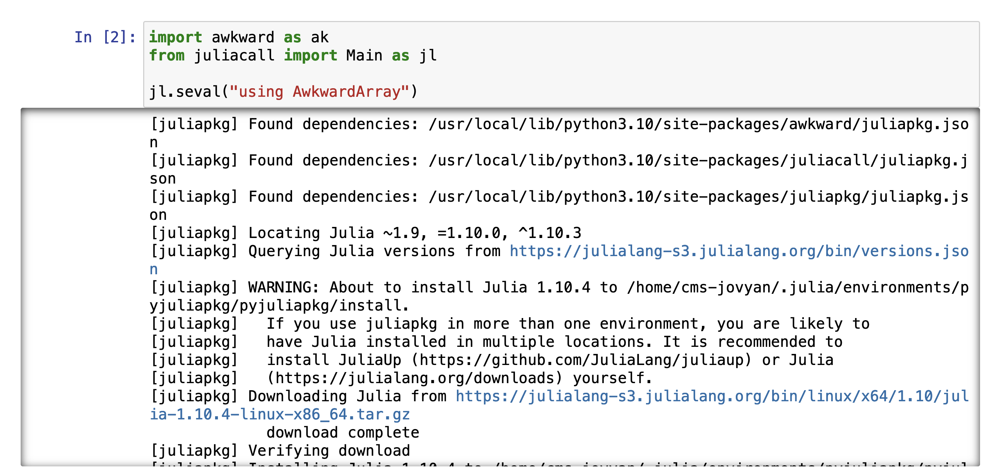

In [2]:
from juliacall import Main as jl
from juliacall import Pkg

Detected IPython. Loading juliacall extension. See https://juliapy.github.io/PythonCall.jl/stable/compat/#IPython


## Best Practices for Managing Dependencies

JuliaUp is recommended way of installing Julia
```python
curl -fsSL https://install.julialang.org | sh
```

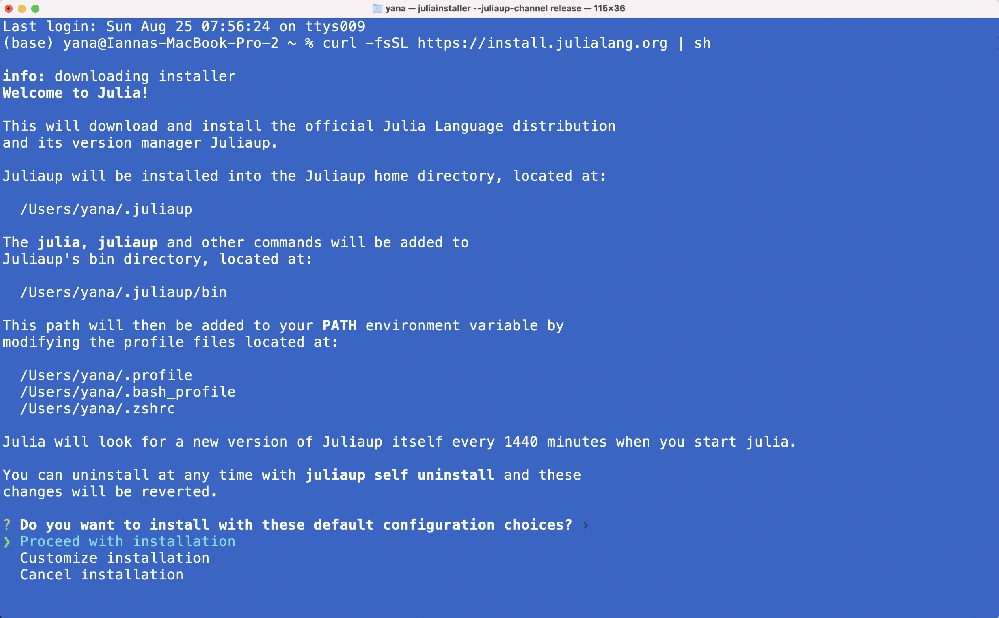

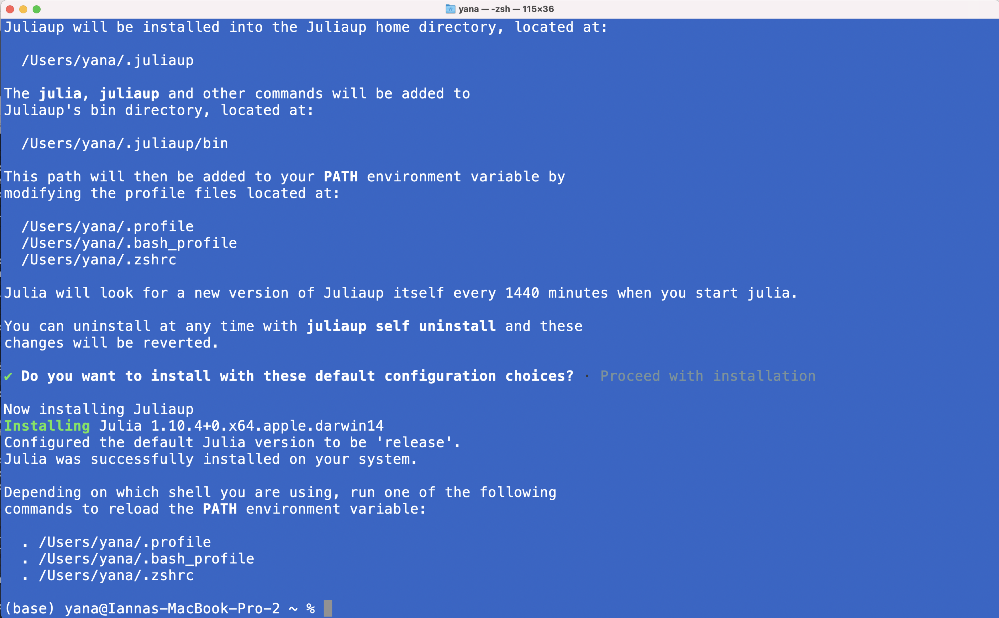

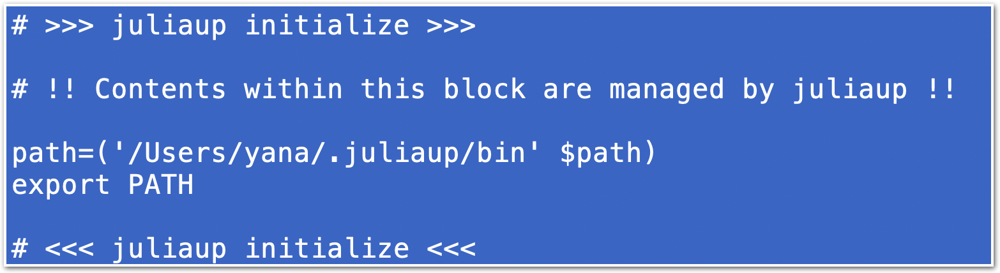

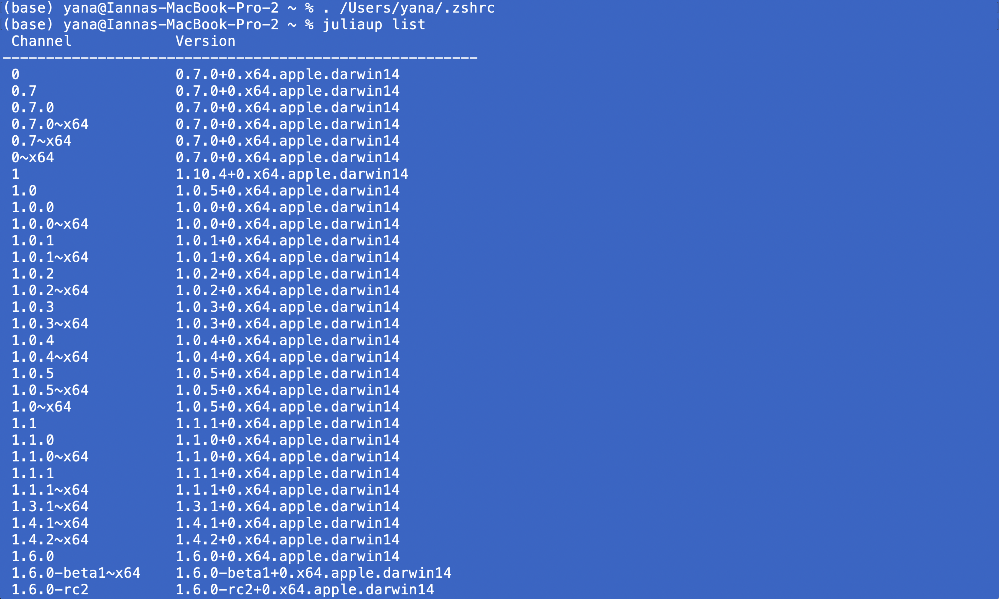

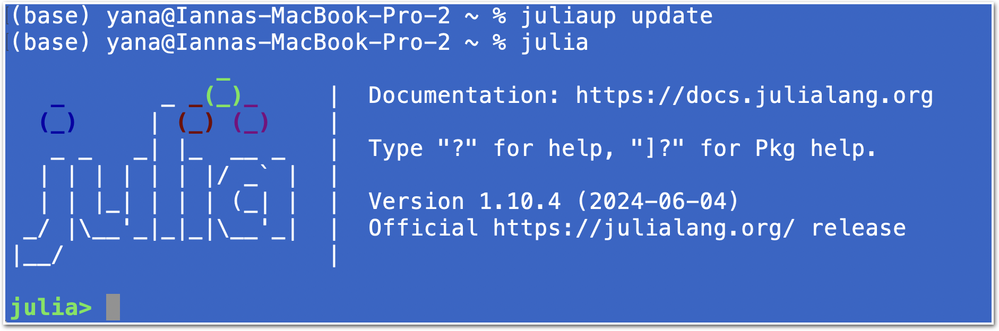

Julia has a state-of-the-art package manager, which allows you to easily manage the computational environment state that your code was designed to run under.

<b>Project.toml</b> and <b>Manifest.toml</b> uniquely identify the package versions that your code uses. 

Julia automatically re-creates the entire configuration of the runtime environment that your code requires to run correctly; it ensures the reproducibility of the programs’ results.

## Using Julia Packages from Python

In [3]:
Pkg.add('AwkwardArray')

   Resolving package versions...
  No Changes to `~/anaconda3/julia_env/Project.toml`
  No Changes to `~/anaconda3/julia_env/Manifest.toml`


In [4]:
jl.seval("using AwkwardArray")

### Example: Automatic differentiation

In [5]:
Pkg.add('ForwardDiff')

   Resolving package versions...
  No Changes to `~/anaconda3/julia_env/Project.toml`
  No Changes to `~/anaconda3/julia_env/Manifest.toml`


In [6]:
jl.seval("using ForwardDiff")

In [7]:
jl.seval('g(x) = x * exp(-x) / (x^2 + 1) * sin(pi * x)')
jl.seval('g1(x) = ForwardDiff.derivative(g, x)')
jl.seval('g2(x) = ForwardDiff.derivative(g1, x)')
jl.seval('g3(x) = ForwardDiff.derivative(g2, x)')

g3 (generic function with 1 method)

In [8]:
def taylor(x, a):
    return jl.g(a) + \
    jl.g1(a) * (x - a) + \
    jl.g2(a) * (x - a)**2 / 2 + \
    jl.g3(a) * (x - a)**3 / 6

In [9]:
domain = ak.Array(np.arange(-2, 2, step=0.05))
image = jl.map(jl.g, domain)
a = -0.4

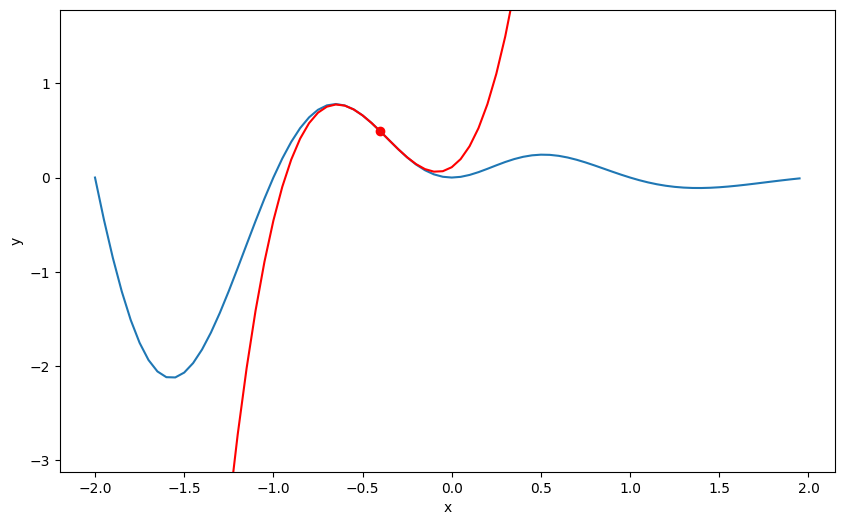

In [10]:
plt.figure(figsize=(10,6))
plt.plot(domain, image, label='f(x)')
plt.scatter([a], [jl.g(a)], color='red', label='a')
plt.plot(domain, taylor(domain, a), color='red', label='3rd order Taylor poly around a')
plt.ylim(ak.min(image) - 1, ak.max(image) + 1)
plt.ylabel('y')
plt.xlabel('x');

### Example: Using AwkwardArray in Julia function

In [11]:
jl.seval("""
function invariant_mass(tree)
  layout = AwkwardArray.PrimitiveArray{Float64}()
  for event in tree
    if event.nMuon == 2
      if event.Muon_charge[1] != event.Muon_charge[2]
        result = sqrt(2 * event.Muon_pt[1] * event.Muon_pt[2] *
                  (cosh(event.Muon_eta[1] - event.Muon_eta[2]) -
                   cos(event.Muon_phi[1] - event.Muon_phi[2])))
        if result > 70
          push!(layout, result)
        end
      end
    end
  end
  layout
end
""")

invariant_mass (generic function with 1 method)

### Example: CMS Data Analysis

In [12]:
Pkg.add('UnROOT')

   Resolving package versions...
  No Changes to `~/anaconda3/julia_env/Project.toml`
  No Changes to `~/anaconda3/julia_env/Manifest.toml`


In [13]:
jl.seval("using UnROOT")

In [14]:
file = jl.Main.ROOTFile("data/SMHiggsToZZTo4L.root")

In [15]:
file

ROOTFile with 1 entry and 18 streamers.
data/SMHiggsToZZTo4L.root
└─ Events (TTree)
   ├─ "run"
   ├─ "luminosityBlock"
   ├─ "event"
   ├─ "⋮"
   ├─ "Electron_dzErr"
   ├─ "MET_pt"
   └─ "MET_phi"


In [16]:
events = jl.Main.LazyTree(file, "Events")

In [17]:
events

 Row │ Electron_mass    nElectron  luminosityBlock  nMuon   Electron_phi     M ⋯
     │ SubArray{Float3  UInt32     UInt32           UInt32  SubArray{Float3  F ⋯
─────┼──────────────────────────────────────────────────────────────────────────
 1   │ []               0          156              3       []               - ⋯
 2   │ [0.00544,        4          156              0       [0.134, -1       2 ⋯
 3   │ [-0.00609,       2          156              0       [2.18, 1.6       - ⋯
 4   │ [-0.00123]       1          156              7       [-0.643]         - ⋯
 5   │ [0.0117, 0       4          156              0       [1.01, -1.       1 ⋯
 6   │ [-0.00183]       1          156              2       [-0.497]         - ⋯
 7   │ [-0.00183]       1          156              1       [-1.47]          - ⋯
 8   │ [-0.00216]       1          156              0       [-0.633]         - ⋯
 9   │ [-0.0128,        4          156              0       [2.79, -2.       - ⋯
 10  │ []               0   

In [18]:
jl.seval("""
using AwkwardArray

function make_record_array(events)
    array = AwkwardArray.RecordArray(
        NamedTuple{(:pt, :eta, :phi, :mass, :charge, :isolation)}((
            AwkwardArray.from_iter(events.Muon_pt),
            AwkwardArray.from_iter(events.Muon_eta), 
            AwkwardArray.from_iter(events.Muon_phi), 
            AwkwardArray.from_iter(events.Muon_mass), 
            AwkwardArray.from_iter(events.Muon_charge), 
            AwkwardArray.from_iter(events.Muon_pfRelIso03_all),
        )
    ))
    return AwkwardArray.convert(array)
end
""")

make_record_array (generic function with 1 method)

In [19]:
%%time
muons = jl.make_record_array(events[1])

CPU times: user 1.29 s, sys: 14.9 ms, total: 1.31 s
Wall time: 1.31 s


In [20]:
%%time
muons = jl.make_record_array(events)

CPU times: user 581 ms, sys: 24.2 ms, total: 605 ms
Wall time: 603 ms


In [21]:
muons = ak.zip({
                "pt": muons.pt,
                "eta": muons.eta,
                "phi": muons.phi,
                "mass": muons.mass,
                "charge": muons.charge,
                "isolation": muons.isolation,
            },
            with_name="PtEtaPhiMCandidate",)

In [22]:
cutflow = dict()

# Sort muons by transverse momentum
muons = muons[ak.argsort(muons.pt, axis=1)]

cutflow["all events"] = ak.num(muons, axis=0)

# Quality and minimum pt cuts
muons = muons[(muons.pt > 5) & (muons.isolation < 0.2)]
cutflow["at least 4 good muons"] = ak.sum(ak.num(muons) >= 4)

In [23]:
# reduce first axis: skip events without enough muons
muons = muons[ak.num(muons) >= 4]

In [24]:
jl.seval("""
using AwkwardArray

four_muons = AwkwardArray.ListArray{
    AwkwardArray.Index64,
    AwkwardArray.ListArray{
        AwkwardArray.Index64,
        AwkwardArray.PrimitiveArray{Int64},
    },
}()

function find_4lep(events_leptons)

    for leptons in events_leptons
        nlep = length(leptons)
        for i0 in 1:nlep
            for i1 in (i0 + 1):nlep
                if leptons[i0][:charge] + leptons[i1][:charge] != 0
                    continue
                end
                for i2 in 1:nlep
                    for i3 in (i2 + 1):nlep
                        if length(Set([i0, i1, i2, i3])) < 4
                            continue
                        end
                        if leptons[i2][:charge] + leptons[i3][:charge] != 0
                            continue
                        end
                        
                        push!(four_muons.content.content, (i0 - 1)) # Julia is 1-based, subtract 1 for 0-based indexing
                        push!(four_muons.content.content, (i1 - 1))
                        push!(four_muons.content.content, (i2 - 1))
                        push!(four_muons.content.content, (i3 - 1))
                        AwkwardArray.end_list!(four_muons.content)
                    end
                end
            end 
        end
        AwkwardArray.end_list!(four_muons)
    end
    return four_muons
end""")

find_4lep (generic function with 1 method)

In [25]:
fourmuon = jl.find_4lep(muons[1:10])

In [26]:
%%time
fourmuon = jl.find_4lep(muons)

CPU times: user 417 ms, sys: 10.4 ms, total: 427 ms
Wall time: 426 ms


In [27]:
fourmuon

14963-element AwkwardArray.ListArray{Vector{Int64}, AwkwardArray.ListArray{Vector{Int64}, AwkwardArray.PrimitiveArray{Int64, Vector{Int64}, :default}, :default}, :default}:
 [[0, 1, 2, 3], [0, 3, 1, 2], [1, 2, 0, 3], [2, 3, 0, 1]]
 [[0, 1, 2, 3], [0, 3, 1, 2], [1, 2, 0, 3], [2, 3, 0, 1]]
 [[0, 1, 2, 3], [0, 3, 1, 2], [1, 2, 0, 3], [2, 3, 0, 1]]
 [[0, 1, 2, 3], [0, 2, 1, 3], [1, 3, 0, 2], [2, 3, 0, 1]]
 [[0, 2, 1, 3], [0, 3, 1, 2], [1, 2, 0, 3], [1, 3, 0, 2]]
 [[0, 1, 2, 3], [0, 3, 1, 2], [1, 2, 0, 3], [2, 3, 0, 1]]
 [[0, 2, 1, 3], [0, 3, 1, 2], [1, 2, 0, 3], [1, 3, 0, 2]]
 [[0, 1, 2, 3], [0, 3, 1, 2], [1, 2, 0, 3], [2, 3, 0, 1]]
 [[0, 2, 1, 4], [0, 2, 3, 4], [0, 4, 1, 2], ..., [3, 4, 0, 2], [3, 4, 1, 2]]
 0-element AwkwardArray.ListArray{Vector{Int64}, AwkwardArray.PrimitiveArray{Int64, Vector{Int64}, :default}, :default}
 ⋮
 [[0, 1, 2, 3], [0, 3, 1, 2], [1, 2, 0, 3], [2, 3, 0, 1]]
 [[0, 1, 2, 3], [0, 2, 1, 3], [1, 3, 0, 2], [2, 3, 0, 1]]
 [[0, 2, 1, 3], [0, 3, 1, 2], [1, 2, 0, 3], [1,